In [3]:
import pandas as pd
import numpy as np
import json
import re
from llms import gemini
from llms import chatGPT
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D  # for 3D plotting
import plotly.express as px
from sklearn.manifold import TSNE
from reportlab.pdfgen import canvas
from reportlab.lib.pagesizes import letter
from reportlab.lib.utils import ImageReader
import plotly.io as pio


x_chat = chatGPT()
x_gemini = gemini()

In [99]:
df = pd.read_csv("../output/bls_df.csv",index_col=0)

df.example_task_embedding = df.example_task_embedding.apply(lambda x: [float(y) for y in x.strip("[]").split(", ")])
df.onet_task_embedding = df.onet_task_embedding.apply(lambda x: [float(y) for y in x.strip("[]").split(", ")])
df.onet_title_embedding = df.onet_title_embedding.apply(lambda x: [float(y) for y in x.strip("[]").split(", ")])

In [42]:
activities_df = pd.read_csv("../input/onet/embeddings/activity_embeddings.csv")
activities_df.embedding = activities_df.embedding.apply(lambda x: [float(y) for y in x.strip("[]").split(", ")])
activity_embeddings = np.vstack(activities_df.embedding)
task_embeddings = np.vstack(df.example_task_embedding)
cosine_sim = cosine_similarity(task_embeddings, activity_embeddings, 'cosine')
activities = list(activities_df.activity)
df[activities] = cosine_sim

In [43]:
skill_activity = pd.read_csv("../input/onet/Skills to Work Activities.csv")[["Work Activities Element Name","Skills Element Name"]]
skill_activity.columns = ["activity","skill"]

In [79]:
for group in skill_activity.groupby("skill"):
    skill = group[0]
    activities = group[1]["activity"].values
    df[skill+"_task"] = df[activities].sum(axis=1)/len(activities)

In [40]:
df.columns

Index(['organization name', 'number', 'Example', 'example_task_embedding',
       'founded date', 'website', 'description_all', 'industries_parsed',
       'generated_description', 'parsed_description',
       ...
       'Repairing_task', 'Service Orientation_task',
       'Social Perceptiveness_task', 'Speaking_task', 'Systems Analysis_task',
       'Systems Evaluation_task', 'Technology Design_task',
       'Time Management_task', 'Troubleshooting_task', 'Writing_task'],
      dtype='object', length=221)

In [123]:
embeddings = np.vstack(df['example_task_embedding'].values)
tsne = TSNE(n_components=3, perplexity=100, n_iter=1000)
tsne_results = tsne.fit_transform(embeddings)
df[["example_task_embedding_tsne1","example_task_embedding_tsne2"]] = tsne_results[:, [0,1]]


embeddings = np.vstack(df['onet_task_embedding'].values)
tsne = TSNE(n_components=3, perplexity=100, n_iter=1000)
tsne_results = tsne.fit_transform(embeddings)
df[["onet_task_embedding_tsne1","onet_task_embedding_tsne2"]] = tsne_results[:, [0,1]]



In [ ]:
embeddings = np.vstack(df['onet_title_embedding'].values)
tsne = TSNE(n_components=3, perplexity=100, n_iter=1000)
tsne_results = tsne.fit_transform(embeddings)
df[["onet_title_embedding_tsne1","onet_title_embedding_tsne2"]] = tsne_results[:, [0,1]]

In [61]:
skills = list(skill_activity.skill.unique()+"_task")


In [69]:
list(df.columns)

['organization name',
 'number',
 'Example',
 'example_task_embedding',
 'founded date',
 'website',
 'description_all',
 'industries_parsed',
 'generated_description',
 'parsed_description',
 'Tasks/Jobs',
 'Industry',
 'Customers',
 'generated_description_conf_interval',
 'parsed_description_conf_interval',
 'organization_name',
 'example',
 'situation_conf_interval',
 'situation_conf_interval_reasoning',
 'job',
 'onet_title',
 'onet_task',
 'example_job_title',
 'task_similarity',
 'job_title_similarity',
 'onet_weight',
 'Major Group',
 'Minor Group',
 'Broad Group',
 'Detailed Occupation',
 'Title_x',
 'Major Group Name',
 'Minor Group Name',
 'Broad Group Name',
 'Active Learning',
 'Active Listening',
 'Complex Problem Solving',
 'Coordination',
 'Critical Thinking',
 'Equipment Maintenance',
 'Equipment Selection',
 'Installation',
 'Instructing',
 'Judgment and Decision Making',
 'Learning Strategies',
 'Management of Financial Resources',
 'Management of Material Resources',

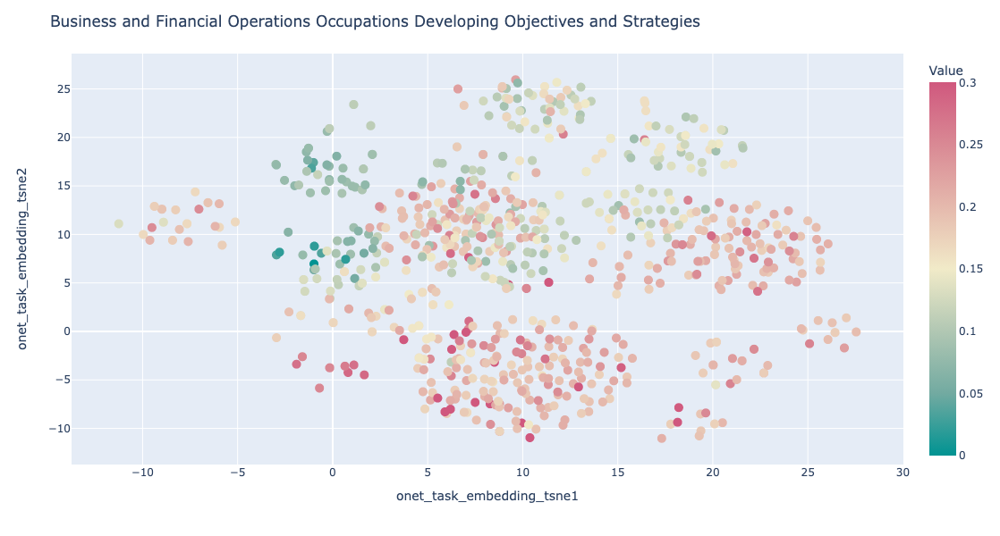

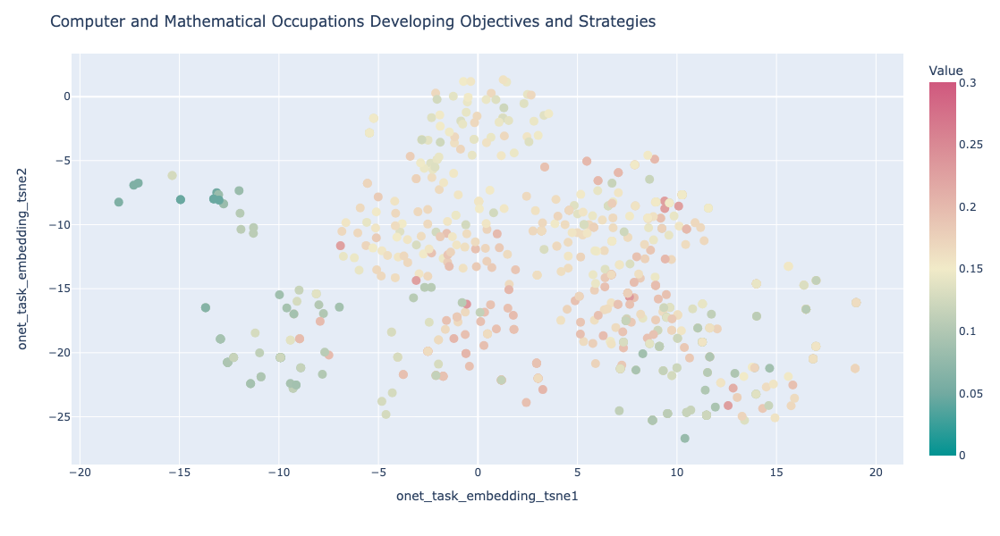

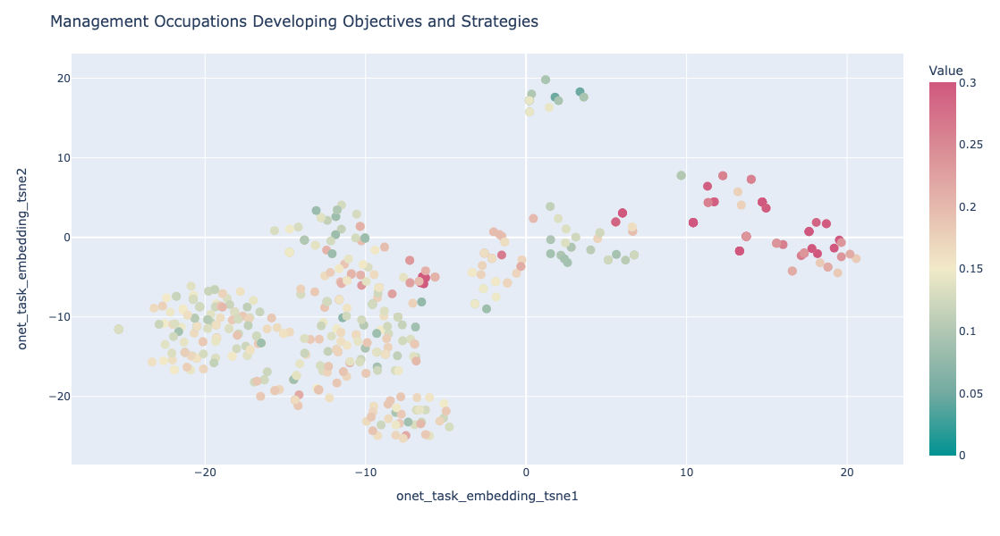

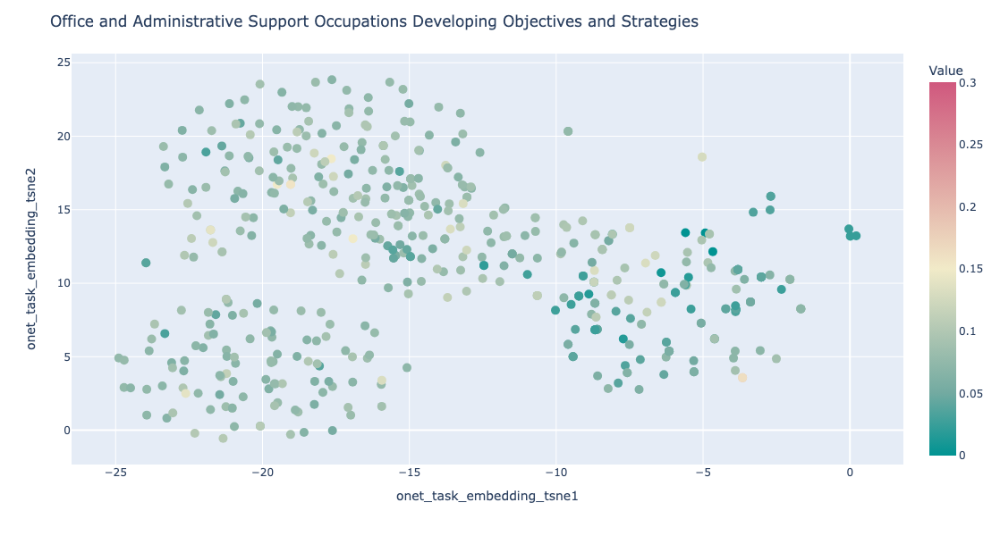

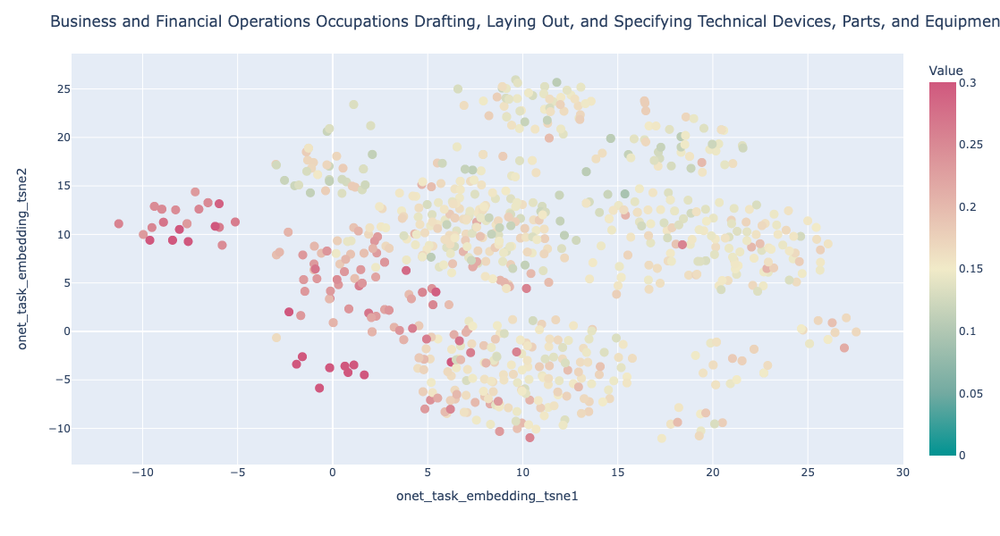

...

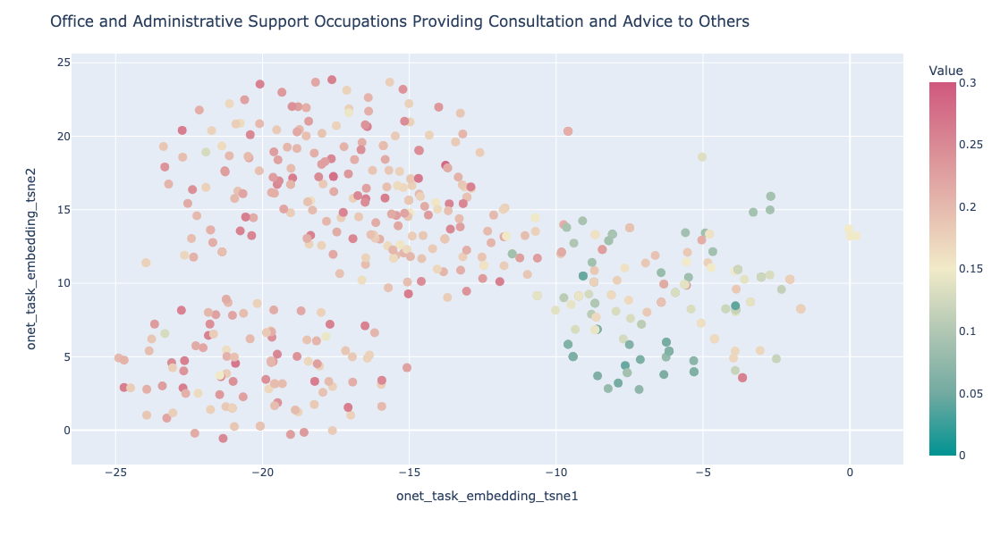

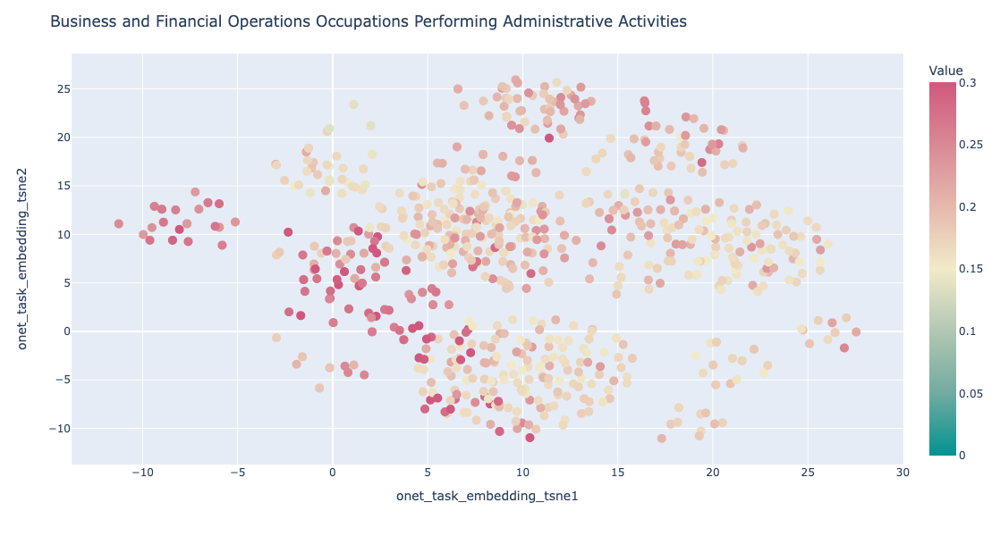

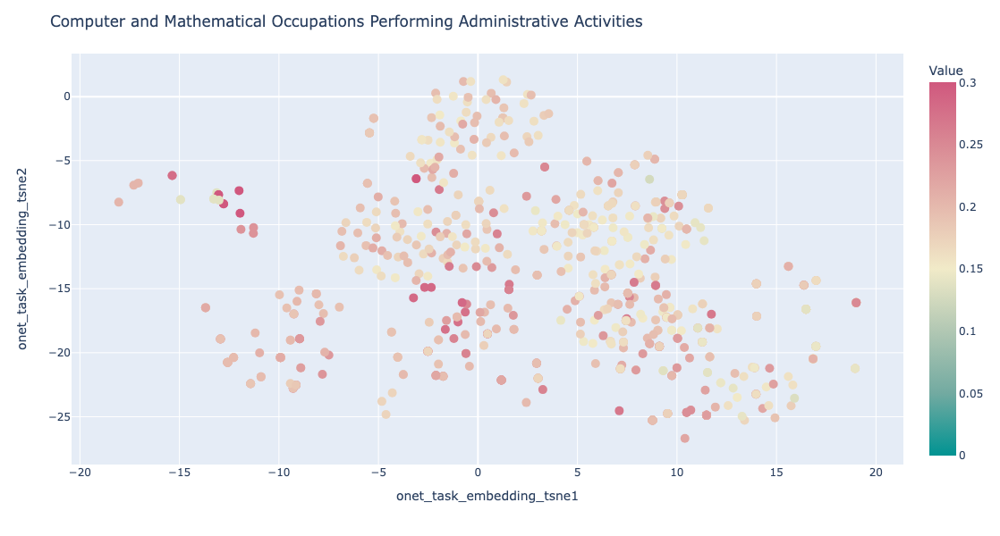

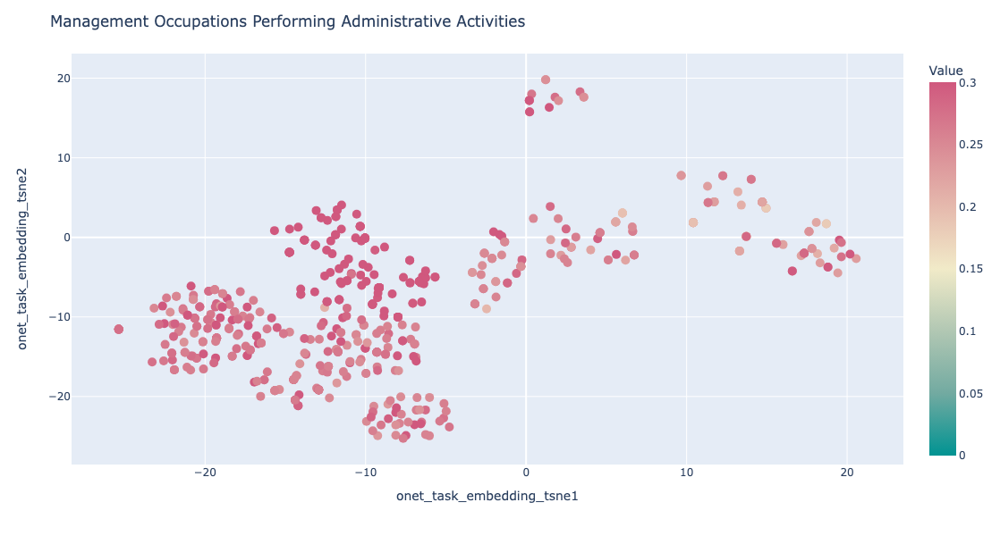

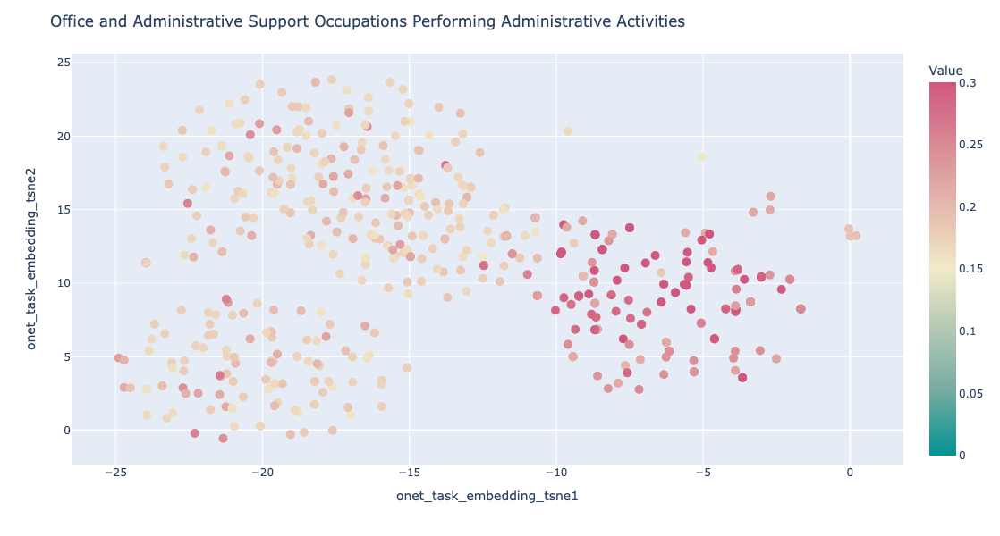

In [84]:
occ_groups = list(df.groupby("Major Group Name")["organization_name"].count().sort_values(ascending=False).index)

for value in activities:
    for occ_group in occ_groups[:4]:
        graph_df = df[df["Major Group Name"] == occ_group]
        graph_df.head()
        # Plot using Plotly with clusters
        fig = px.scatter(graph_df, x='onet_task_embedding_tsne1', y='onet_task_embedding_tsne2',
                         color=value,
                         color_continuous_scale=px.colors.diverging.Tealrose,
                         hover_data=['onet_task'],
                         range_color=[0, .3],
                         labels={value: 'Value'})
        fig.update_traces(marker_size=10)                  
        
        fig.update_layout(
            title=f"{occ_group} {value}", 
            hovermode='closest',
            width=1000,  # Set the width of the figure
            height=600  # Set the height of the figure
        )
        fig.show()

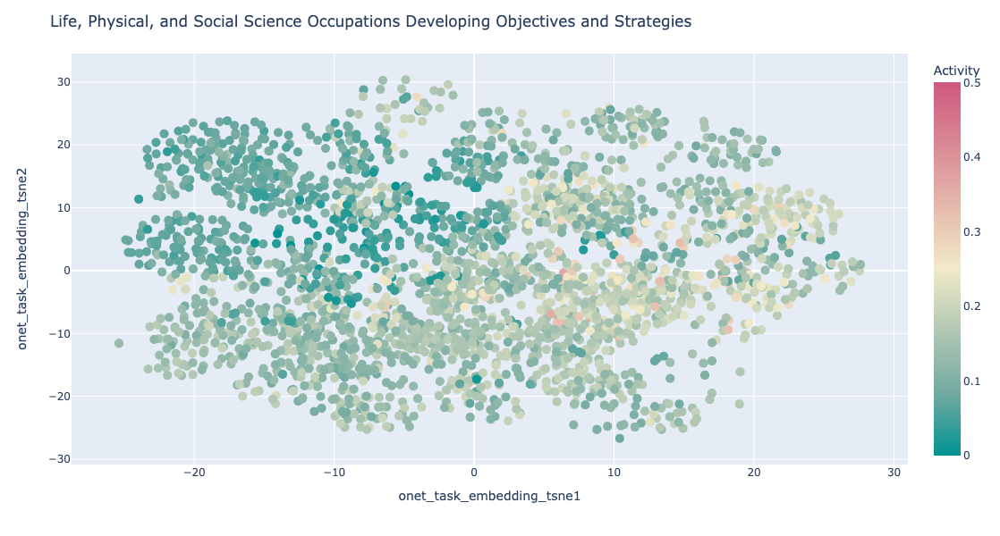

In [74]:
activity = "Developing Objectives and Strategies"
fig = px.scatter(df, x='onet_task_embedding_tsne1', y='onet_task_embedding_tsne2',
                         color=activity,
                         color_continuous_scale=px.colors.diverging.Tealrose,
                         hover_data=['onet_task'],
                         range_color=[0, .5],
                         labels={activity: 'Activity'})
fig.update_traces(marker_size=10)

fig.update_layout(
    title=f"{occ_group} {activity}", 
    hovermode='closest',
    width=1000,  # Set the width of the figure
    height=600  # Set the height of the figure
)
fig.show()

In [107]:
dwa = pd.read_csv("../input/onet/Tasks to DWAs.csv")
dwa = dwa[["DWA Title","DWA ID","Task"]]


In [110]:
dwa_ref = pd.read_csv("../input/onet/DWA Reference.csv")[["Element Name","DWA ID"]]

In [111]:
df = df.merge(dwa, on="Task",how="left")
df = df.merge(dwa_ref, on="DWA ID",how="left")

In [130]:
element_counts = df["Element Name"].value_counts()
colors = px.colors.qualitative.Plotly
color_map = {element: colors[i % len(colors)] for i, element in enumerate(element_counts.index)}
df['Color'] = df['Element Name'].map(color_map)

In [135]:
df.groupby("Minor Group Name")["organization_name"].count().sort_values(ascending=False)

Minor Group Name
Postsecondary Teachers                                                                           8594
Computer Occupations                                                                              845
Business Operations Specialists                                                                   673
Financial Specialists                                                                             634
Operations Specialties Managers                                                                   611
Information and Record Clerks                                                                     434
Mathematical Science Occupations                                                                  216
Other Management Occupations                                                                      209
Preschool, Elementary, Middle, Secondary, and Special Education Teachers                          194
Media and Communication Workers                                  

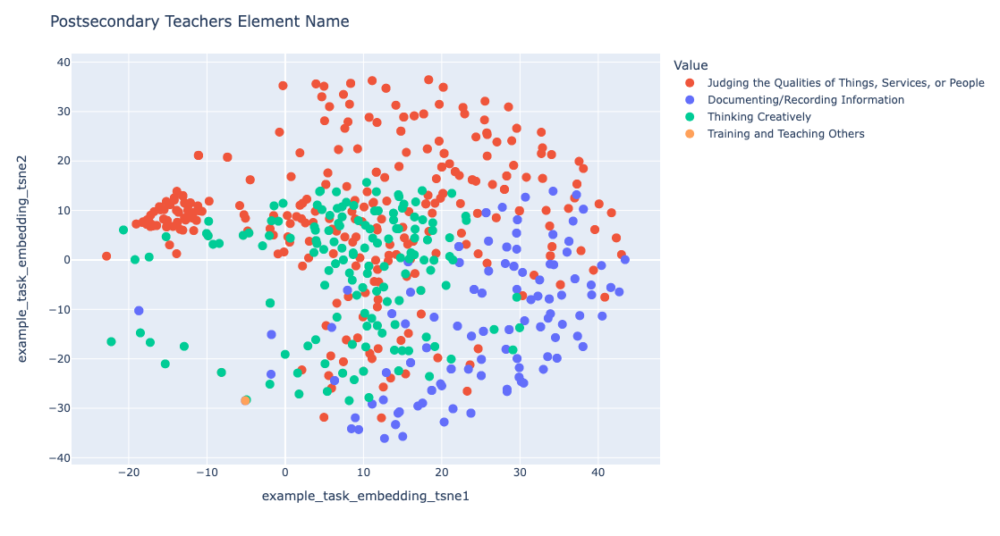

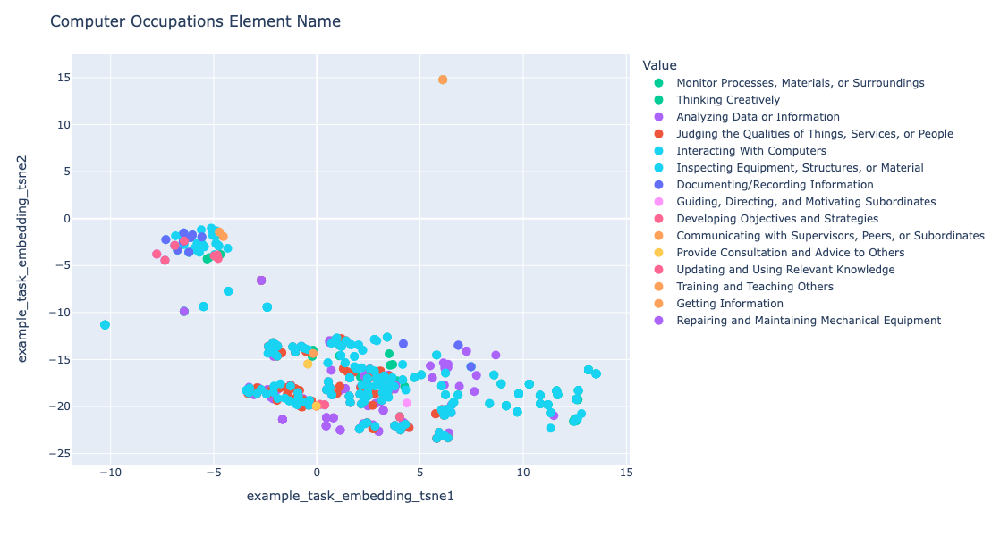

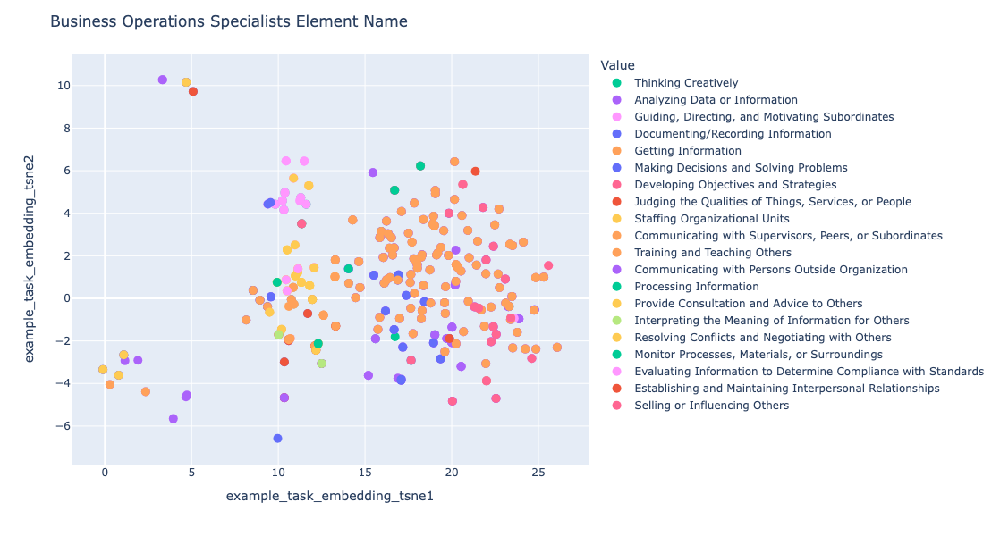

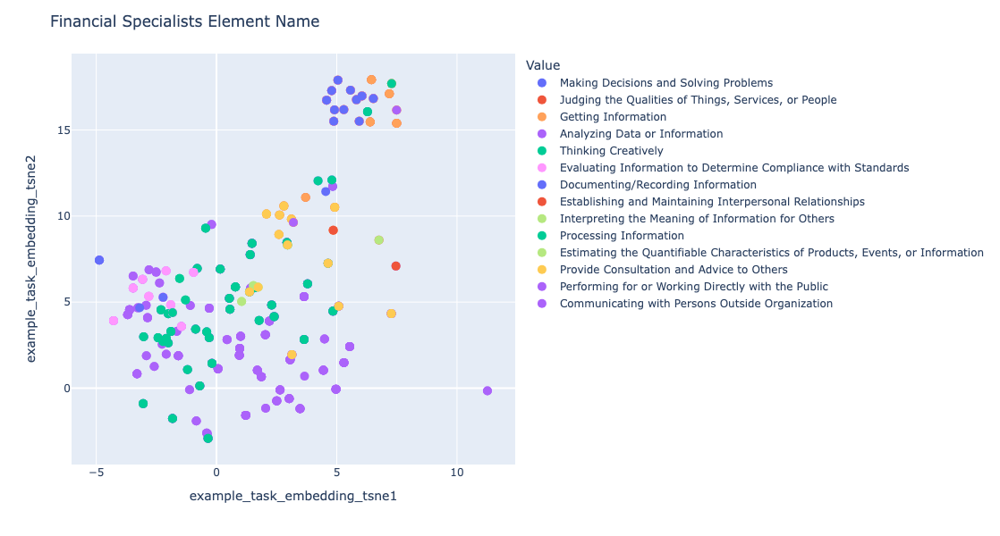

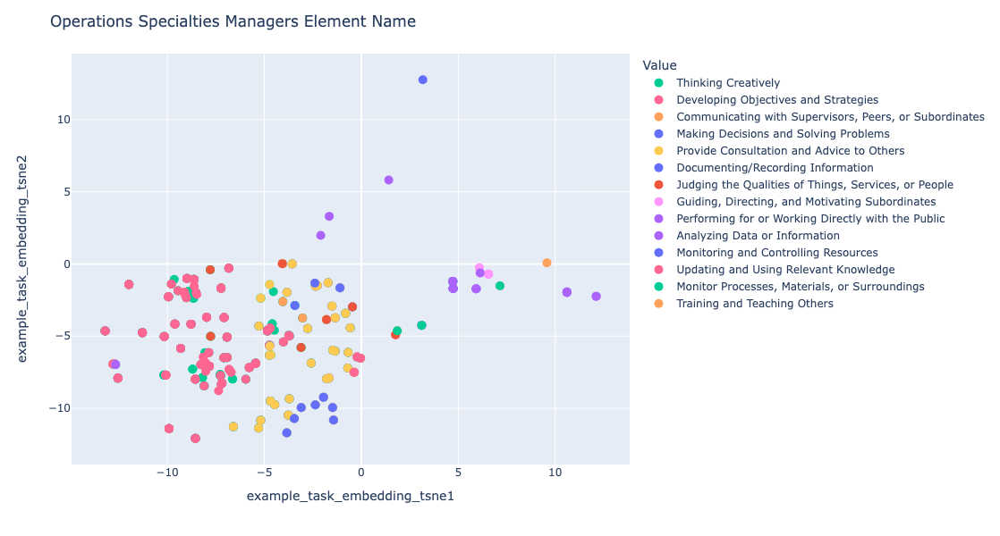

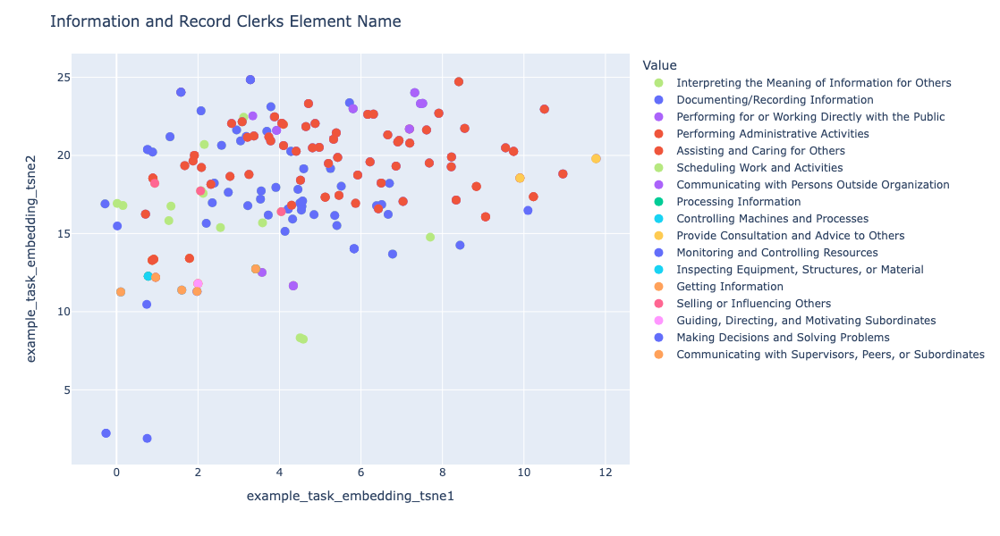

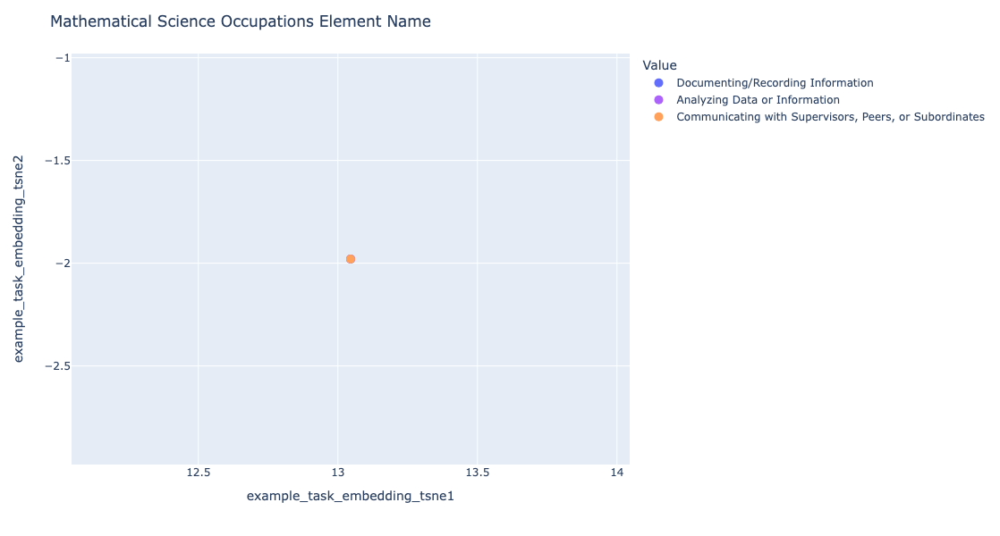

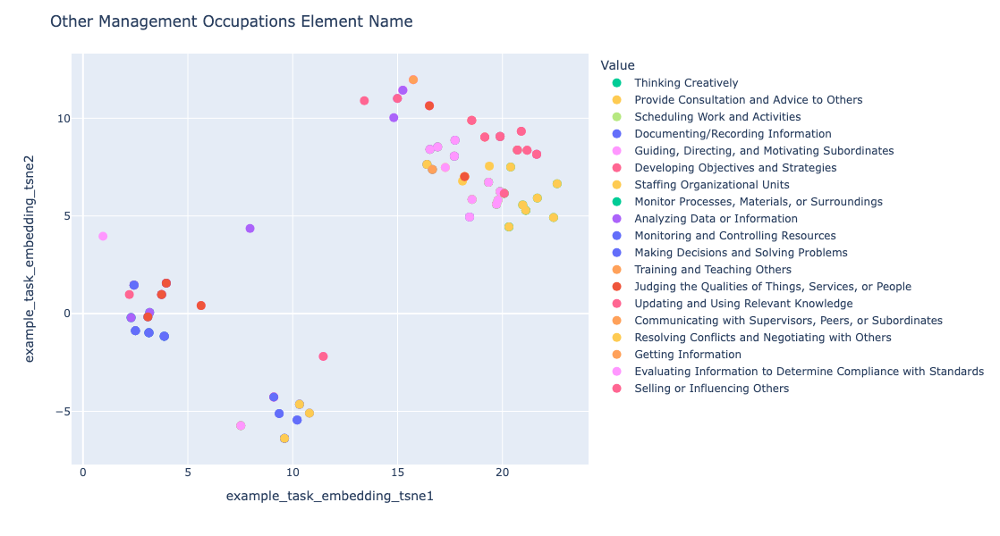

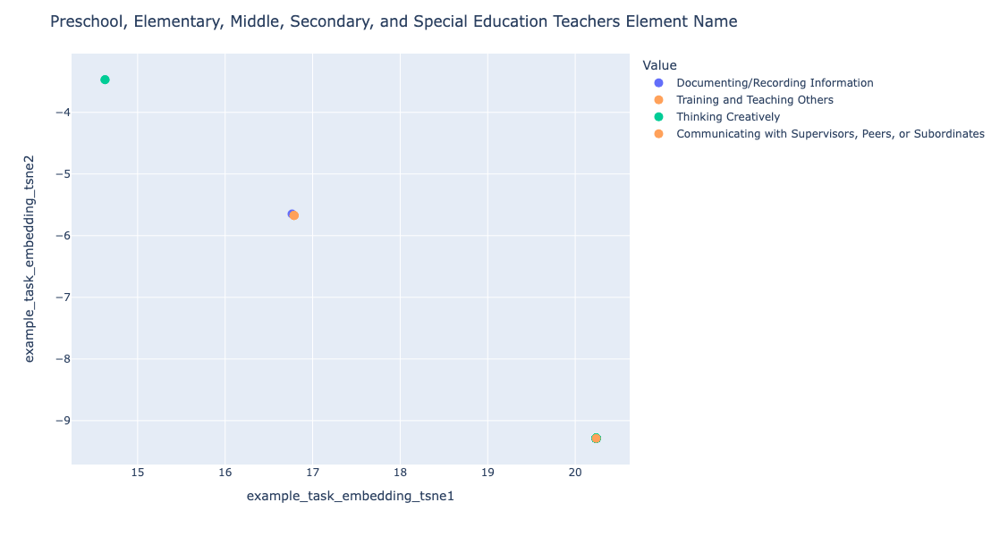

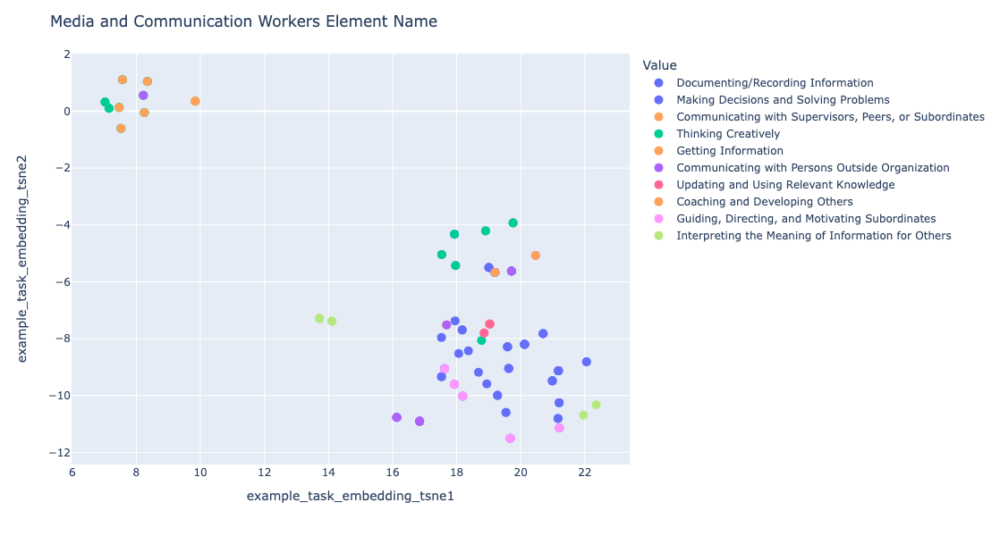

In [133]:
occ_groups = list(df.groupby("Minor Group Name")["organization_name"].count().sort_values(ascending=False).index)

value = "Element Name"
for occ_group in occ_groups[:10]:
    graph_df = df[df["Minor Group Name"] == occ_group]
    graph_df.head()
    # Plot using Plotly with clusters
    fig = px.scatter(graph_df, x='example_task_embedding_tsne1', y='example_task_embedding_tsne2',
                     color=value,
                     hover_data=['onet_task'],
                     color_discrete_map=color_map,
                     range_color=[0, .3],
                     labels={value: 'Value'})
    fig.update_traces(marker_size=10)                  
    
    fig.update_layout(
        title=f"{occ_group} {value}", 
        hovermode='closest',
        width=1000,  # Set the width of the figure
        height=600  # Set the height of the figure
    )
    fig.show()

In [98]:
len(lf["DWA ID"].unique())

517

In [89]:
len(pd.read_csv("../input/onet/Tasks to DWAs.csv")["DWA Title"].unique())

2070

In [119]:
df.to_csv("../output/df_tsne.csv")

In [134]:
len(df)

14068

In [ ]:
- socio economic status 
- hourly annual 
- pew research center website socio economic data
- location of jobs
- related occupation, group by most links
https://www.bls.gov/oes/tables.htm